# Análisis Exploratorio de Datos (EDA) - GOOGLE MAPS

## Introducción
Este documento presenta un Análisis Exploratorio de Datos (EDA) aplicado al conjunto de datos de Google Maps. El objetivo principal es mejorar la comprensión de la información contenida en los archivos Parquet relacionados con banks, metadata y reviews

* 10 nombres de bancos más frecuentes: Identificar los 10 nombres de los bancos nacionales establecidos en todo Estados Unidos y  visualizar esto con un gráfico de barras para una presentación más impactante. 

* Histograma de Avg_rating: Comprender la distribución de las calificaciones promedio
  
* Top Bancos y Características Principales: Identificar los bancos con las puntuaciones promedio más altas y más bajas.

* Mapa de dispersión: Este gráfico proporciona una visualización geoespacial de la ubicación de los bancos, destacando la puntuación promedio y el número de reseñas para cada uno.

* Mapa interactivo: muestra las ubicaciones de los bancos 


In [1]:
# Importar bibliotecas necesarias
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium

In [4]:
#Obtener la ruta del archivo
file_path = '../data/Cloud Upload/Google Maps/metadata-sitios.snappy.parquet'

# Lee el archivo Parquet en un DataFrame
df_metadata = pd.read_parquet(file_path, engine='pyarrow')

# Muestra las primeras 5 fil
df_metadata.head(5)


,name,gmap_id,latitude,longitude,avg_rating,num_of_reviews,url
0,Gwinnett Community Bank,0x88f5a28359cb48cd:0xacc5f8fde9522f87,34.007883,-84.133413,3.0,2,https://www.google.com/maps/place//data=!4m2!3...
1,SouthState Bank,0x885831d2e81f802b:0x843f06a637f8b16c,34.846505,-82.397261,4.1,8,https://www.google.com/maps/place//data=!4m2!3...
2,Trustmark,0x887f9192fb220229:0x486fb6debed2b946,34.962989,-89.829834,4.2,5,https://www.google.com/maps/place//data=!4m2!3...
3,Central Bank,0x87c4c5c389616dd3:0x4349da2a75562d97,38.192834,-92.644184,4.5,44,https://www.google.com/maps/place//data=!4m2!3...
4,Lead Bank Crossroads,0x87c0f0420957bdcb:0xc5d1384c055cac32,39.091499,-94.583367,4.5,18,https://www.google.com/maps/place//data=!4m2!3...


In [5]:

# 10 nombres de bancos más frecuentes
df_metadata['name'].value_counts().head(10)


name
Chase Bank                               2511
Wells Fargo Bank                         2365
Bank of America (with Drive-thru ATM)    1212
U.S. Bank Branch                          945
PNC Bank                                  806
Bank of America Financial Center          587
TD Bank                                   567
BB&T                                      492
Regions Bank                              453
SunTrust                                  395
Name: count, dtype: int64

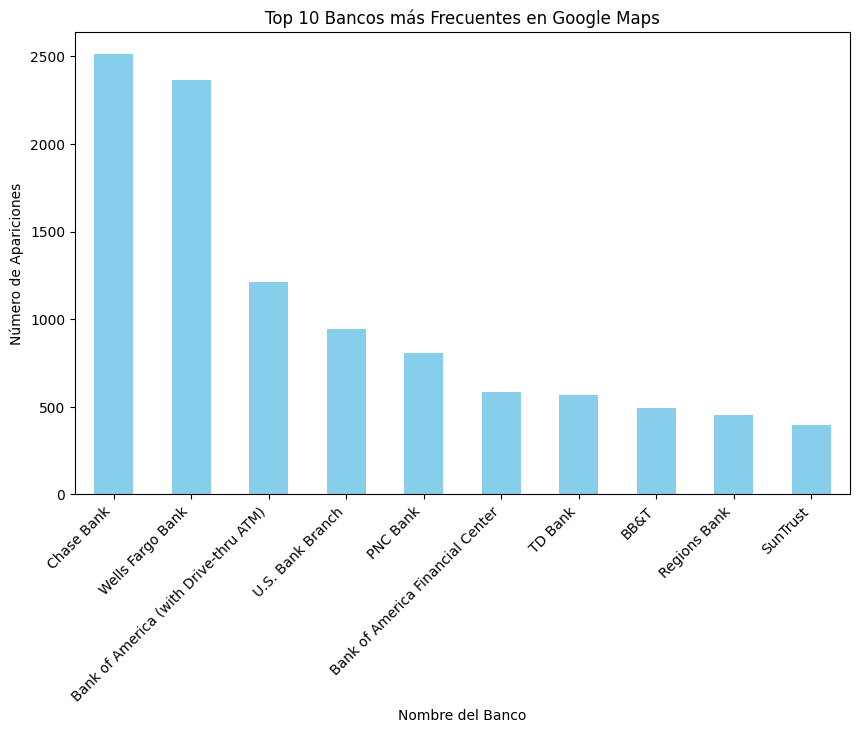

In [6]:
# Crea un gráfico de barras para los 10 bancos más frecuentes
plt.figure(figsize=(10, 6))
top_banks = df_metadata['name'].value_counts().head(10)
top_banks.plot(kind='bar', color='skyblue')
plt.title('Top 10 Bancos más Frecuentes en Google Maps')
plt.xlabel('Nombre del Banco')
plt.ylabel('Número de Apariciones')
plt.xticks(rotation=45, ha='right')
plt.show()

    Estos datos muestran que Chase Bank, Wells Fargo Bank, Bank of America (with Drive-thru ATM), U.S. Bank Branch y PNC Bank son las instituciones más frecuentes. Todos estos son bancos nacionales bien establecidos con un amplio alcance en todo Estados Unidos.  
  

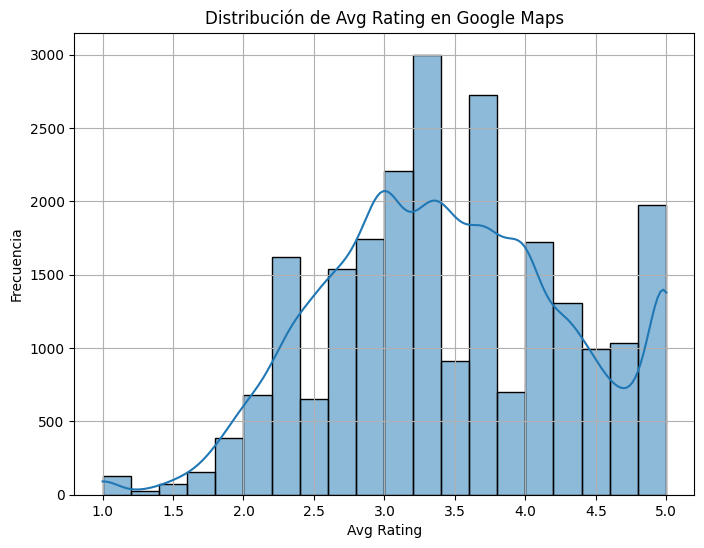

In [7]:
# Crea un histograma con etiquetas en los ejes
plt.figure(figsize=(8, 6))
sns.histplot(df_metadata['avg_rating'], bins=20, kde=True)
plt.title('Distribución de Avg Rating en Google Maps')
plt.xlabel('Avg Rating')
plt.ylabel('Frecuencia')
plt.grid(True)  # Agrega una cuadrícula para mayor claridad
plt.show()

    La mayoría de las calificaciones se encuentran en el rango de 3.0 a 4.0, con una menor cantidad de calificaciones en los rangos más bajos y más altos.

    La curva superpuesta al histograma es una estimación de la densidad de probabilidad de la variable avg_rating.

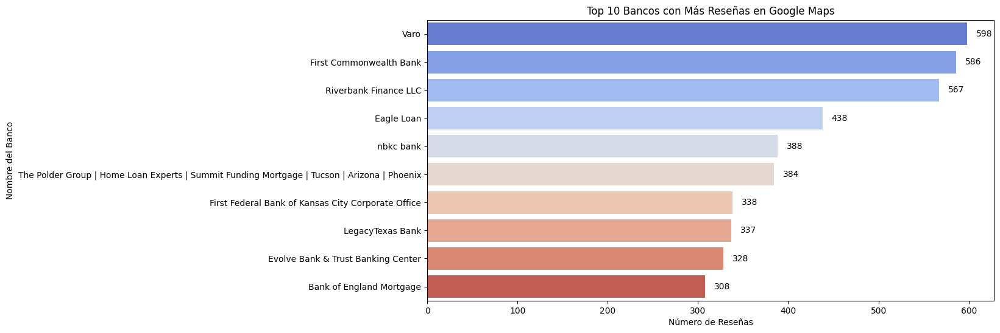

In [11]:
# Crea un gráfico de barras con números exactos de reseñas

top_banks_reviews = df_metadata.nlargest(10, 'num_of_reviews')
plt.figure(figsize=(12, 6))
sns.barplot(x='num_of_reviews', y='name', data=top_banks_reviews, palette='coolwarm')
for i, value in enumerate(top_banks_reviews['num_of_reviews']):
    plt.text(value + 10, i, str(value), va='center')
plt.title('Top 10 Bancos con Más Reseñas en Google Maps')
plt.xlabel('Número de Reseñas')
plt.ylabel('Nombre del Banco')
plt.show()

    Podemos observar que los 10 bancos con más reseñas y sus respectivos números de reseñas, el banco Varo con 598 reseñas y el que menos tiene es Bank of England Mortgage con 308 reseñas

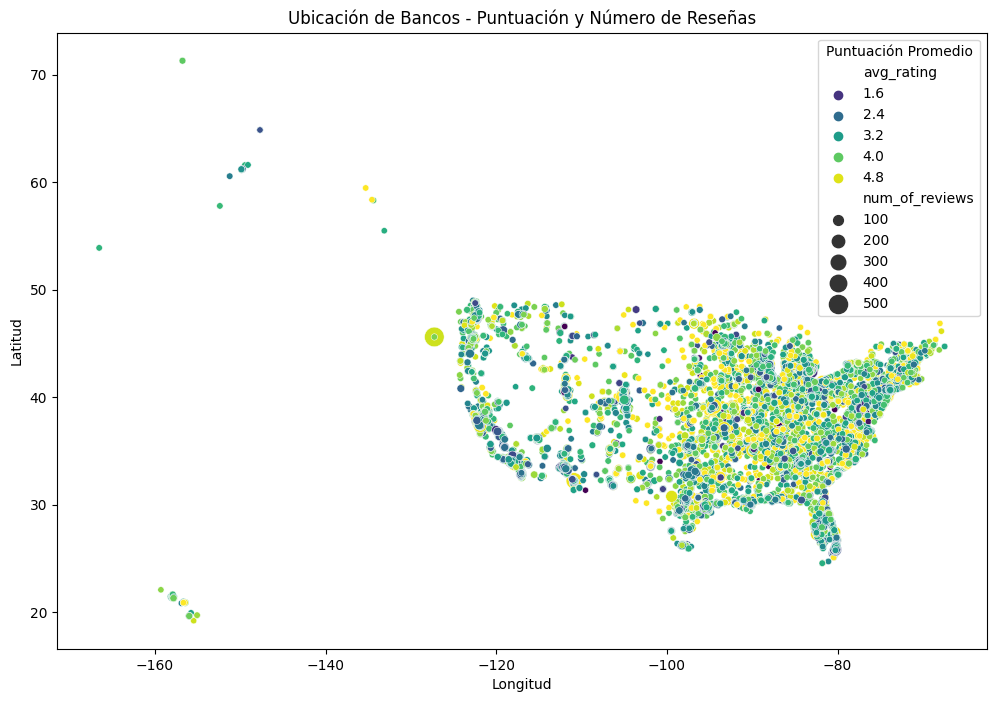

In [15]:
# Mapa de dispersión geoespacial
plt.figure(figsize=(12, 8))
sns.scatterplot(x='longitude', y='latitude', data=df_metadata, hue='avg_rating', palette='viridis', size='num_of_reviews', sizes=(20, 200))
plt.title('Ubicación de Bancos - Puntuación y Número de Reseñas')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.legend(title='Puntuación Promedio')
plt.show()

    Cada punto representa la ubicación geográfica de un banco. La posición en el mapa está determinada por las columnas 'longitude' (longitud) y 'latitude' (latitud) del DataFrame df_metadata, los puntos están coloreados según la puntuación promedio del banco ('avg_rating'), y el tamaño de los puntos está escalado por el número de reseñas ('num_of_reviews')

In [17]:
# Crea un mapa interactivo
mapa_interactivo = folium.Map(location=[40.7127, -74.0059], zoom_start=10)

# Agrega las ubicaciones de los bancos al mapa
for i in range(df_metadata.shape[0]):
    folium.Marker([df_metadata['latitude'].iloc[i], df_metadata['longitude'].iloc[i]], popup=df_metadata['name'].iloc[i]).add_to(mapa_interactivo)

# Guarda el mapa interactivo como archivo HTML
mapa_interactivo.save('mapa_interactivo_google_maps.html')

# Muestra el mapa
mapa_interactivo

In [14]:
#Obtener la ruta del archivo
file_path = '../data/Cloud Upload/Google Maps/reviews.snappy.parquet'

# Lee el archivo Parquet en un DataFrame
df_reviews = pd.read_parquet(file_path, engine='pyarrow')

# Muestra las primeras 5 fila
df_reviews.head(5)

""


# Conclusiones del Análisis Exploratorio de Datos (EDA) de Google Maps

Proporciona una visión detallada de la distribución y características de los bancos en Estados Unidos:

* Nombres de Bancos más Frecuentes:

    Se identificaron los 10 nombres de bancos más frecuentes, destacando que Chase Bank, Wells Fargo Bank y Bank of America son las instituciones más comunes y bien establecidas a nivel nacional.

* Histograma de Avg_rating:

    La mayoría de las calificaciones se encuentran en el rango de 3.0 a 4.0, indicando que la mayoría de los bancos tienen una calificación aceptable. Este análisis puede ser útil para comprender la percepción general de los usuarios sobre los bancos en el conjunto de datos.

* Top Bancos con Más Reseñas:

    Se identificaron los bancos con más reseñas, con Varo liderando la lista con 598 reseñas. Incluir el número exacto de reseñas en las barras facilita una referencia rápida.

* Mapa de Dispersión Geoespacial:

    El mapa de dispersión geoespacial resalta la ubicación de los bancos con colores que representan las puntuaciones promedio y tamaños que indican el número de reseñas. Se observa una distribución geográfica de los bancos y cómo varían en popularidad y puntuación en diferentes regiones.

* Mapa Interactivo:

    Nos permite una exploración más detallada y personalizada de la ubicación de los bancos. 
